In [1]:
import seedpod_ground_risk.api as spgr
import shapely.geometry as sg
from seedpod_ground_risk.core.utils import *

# Setup

### Aircraft model

In [2]:
# Create a default demo aircraft
from seedpod_ground_risk import cli
aircraft = cli._setup_default_aircraft()

fail_prob = 5e-3 #probability of uncontrolled failure per flight hour

###  Map bounds and Route Details

In [3]:
bounds = (50.71, -1.75, 51.04, -1.2) #map area (south, west, north, east) bounds. Set in decimal degrees

sgh_coords = (50.933531, -1.432179)#Southampton General Hospital coords

crz_alt = 100 #m ~300ft, cruise altitude in metres
crz_tas = 25 #m/s ~50kts, cruise true airspeed in m/s
route_time = 12 #24hr time of sortie

routes = [
    {'name': 'BH25 Group (New Milton)',
     'start':(50.7593, -1.65749), 
     'end': sgh_coords,
     'hour': route_time,
     'crz_alt': crz_alt,
     'crz_tas': crz_tas,
     'aircraft': aircraft
    },
    {'name': 'SO41 0PG Group (Milford on Sea)',
     'start':(50.7236, -1.58897),
     'end': sgh_coords,
     'hour': route_time,
     'crz_alt': crz_alt,
     'crz_tas': crz_tas,
     'aircraft': aircraft
    },
    {'name': 'SO45 1XA (Blackfield)',
     'start':(50.8173, -1.37188), 
     'end': sgh_coords,
     'hour': route_time,
     'crz_alt': crz_alt,
     'crz_tas': crz_tas,
     'aircraft': aircraft
    },
]

### External Environment

In [4]:
wind_dir = 240 #wind bearing, this is the direction the wind is COMING FROM
wind_vel = 5 #Wind Velocity in m/s

map_resolution = 65 # resolution of each pixel of risk map in m^2
# Setting map resolution too high can give strange CUDA malloc errors as Windows forcibly
# restarts the GPU driver when it (thinks it) hangs for too long. Depends on GPU, YMMV

# Set fairly coarse here for debugging

# Making the maps

In [5]:
# Convert bounds tuple to geometry we can work with
bounds_poly = sg.box(*bounds)
# Get all unique times and generate fatality maps for them
unique_times = {r['hour'] for r in routes}
#Generate pop density maps
pop_maps = {hour : spgr.make_pop_grid(bounds_poly, hour, map_resolution) for hour in unique_times} 


OSM query took  3.83750319480896
OSM query took  1.9935970306396484
OSM query took  1.650956392288208
OSM query took  1.9182934761047363
OSM query took  0.9613461494445801
OSM query took  1.473264217376709
OSM query took  1.1671154499053955
OSM query took  0.9615886211395264
OSM query took  0.9126894474029541
OSM query took  1.242156982421875
OSM query took  1.5399048328399658


In [6]:
# Ensure all parameters are valid

import casex
for route in routes:
    assert bounds_poly.contains(sg.Point(*route['start']))
    assert bounds_poly.contains(sg.Point(*route['end']))
    
    assert route['hour'] >= 0
    assert route['hour'] < 168
    
    assert route['crz_alt'] > 0
    assert route['crz_tas'] > 0
    
    assert type(route['aircraft']) is casex.AircraftSpecs
    
assert wind_dir >= 0
assert wind_dir <= 360
assert wind_vel >= 0

### Route specific risk maps

In [7]:
# Create caches if do not already exist
try:
    strike_maps
    fatality_maps
except NameError:
    # Map routes to their risk maps as memoisation
    strike_maps = dict()
    fatality_maps = dict()

In [8]:
for route in routes:
    route_fs = tuple(route.items())
    if route_fs not in strike_maps:
        # Get the strike map and impact velocities
        strike_map, v_is = spgr.make_strike_grid(
            route['aircraft'] , route['crz_tas'], route['crz_alt'], fail_prob, pop_maps[route['hour']],
            map_resolution, wind_dir, wind_vel)
        strike_maps[route_fs] = strike_map
    
    if route_fs not in fatality_maps:
        # Get fatality risk map
        fatality_map = spgr.make_fatality_grid(aircraft, strike_map, v_is)
        fatality_maps[route_fs] = fatality_map

CUDA found, using config <<<(27, 28),(32, 32)>>>
CUDA found, using config <<<(27, 28),(32, 32)>>>
CUDA found, using config <<<(27, 28),(32, 32)>>>


### Add Obstacles

In [9]:
import geopandas as gpd
frzs = gpd.read_file('static_data/FRZs.json')

obstacle_raster = spgr.add_obstacles(bounds_poly.bounds, frzs, strike_map.shape)
for maps in (strike_maps, fatality_maps):
    for k, map_ in maps.items():
        maps[k] = map_ + obstacle_raster

p:\dev\sandbox\edrone_routes\edr\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


### Serialisation

In [10]:
import pickle as pkl

with open('strike_maps.pkl', 'wb') as f:
    pkl.dump(strike_maps, f)
with open('fatality_maps.pkl', 'wb') as f:
    pkl.dump(fatality_maps, f)

In [11]:
if input() == 'yes':
    import pickle as pkl

    with open('strike_maps.pkl', 'rb') as f:
        strike_maps = pkl.load(f)
    with open('fatality_maps.pkl', 'rb') as f:
        fatality_maps = pkl.load(f)

## Test Plots

Sanity check plots

In [12]:
import matplotlib.pyplot as mpl

### Strike Maps

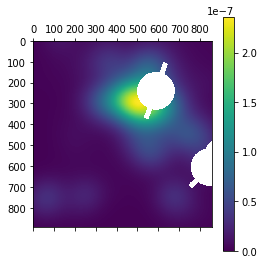

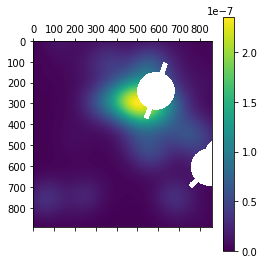

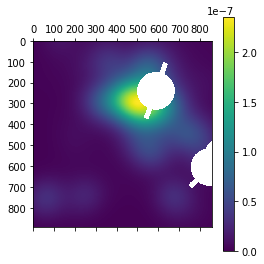

In [13]:
for sm in strike_maps.values():
    mpl.matshow(sm, vmin=0)
    mpl.colorbar()

### Fatality Maps

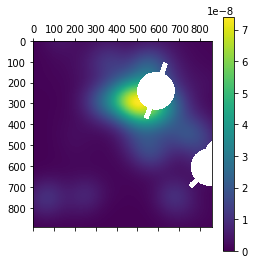

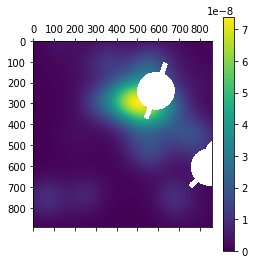

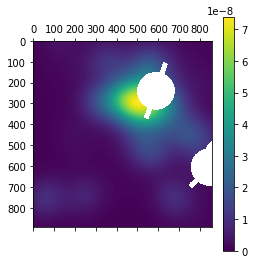

In [14]:
for fm in fatality_maps.values():
    mpl.matshow(fm, vmin=0)
    mpl.colorbar()

# Paths

In [15]:
# Create caches if do not already exist
try:
    paths
except NameError:
    # Map routes to their risk maps as memoisation
    paths = dict()

In [152]:
paths = dict()
grid_paths = dict()
path_costs = dict()


for route in routes:
    route_fs = tuple(route.items())
    if route_fs not in paths:
        path, grid_path, path_cost = spgr.make_path(fatality_maps[route_fs], bounds_poly, route['start'], route['end'], algo='rt*', thres=2.5e-9, smooth=False, pathwise_cost=True)
        paths[route_fs] = path
        grid_paths[route_fs] = grid_path
        path_costs[route_fs] = path_cost

# Plots

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
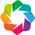

In [17]:
import holoviews as hv
import bokeh 
import geoviews as gv
hv.extension('bokeh')

tiles = gv.tile_sources.OSM

flipped_bounds = (bounds[1], bounds[0], bounds[3], bounds[2]) # Holoviews expects (left, bottom, right, top) order

In [153]:
import geopandas as gpd

layouts = []
for sm, fm, path, path_cost in zip(strike_maps.values(), fatality_maps.values(), paths.values(), path_costs.values()):
    path_df = gpd.GeoDataFrame({'geometry': [path]}).set_crs('EPSG:4326')
    path_contour = gv.Contours(path_df).opts(line_width=2, line_color='magenta')
    risk_map = gv.Image(fm, vdims=['fatality_risk'], bounds=flipped_bounds)\
                .opts(alpha=0.8, colorbar=True, colorbar_opts={'title': "Fatality Risk h^-1"},
                      cmap='viridis', width=650, height=450)
    fm_overlay = (tiles * risk_map * path_contour)
    
    path_cost = np.hstack(path_cost)
    path_length = path_df.to_crs('EPSG:3395').iloc[0].geometry.length
    xs = np.linspace(0, path_length, num=len(path_cost))
    path_cost_plot = hv.Curve((xs, path_cost), 'Path Distance [m]', 'Fatality Risk [h^-1]')\
                        .opts(width=650, height=150)
    layouts.append((fm_overlay + path_cost_plot).cols(1))
    
hv.HoloMap({f'Route {i}' : layouts[i] for i in range(len(layouts))}).collate()


:Layout
   .Overlay.I :HoloMap   [Default]
      :Overlay
         .WMTS.I     :WMTS   [Longitude,Latitude]
         .Image.I    :Image   [Longitude,Latitude]   (fatality_risk)
         .Contours.I :Contours   [Longitude,Latitude]
   .Curve.I   :HoloMap   [Default]
      :Curve   [Path Distance [m]]   (Fatality Risk [h^-1])

In [154]:
for i, path in enumerate(paths.values()):
    name = routes[i]['name']
    gpd.GeoDataFrame({'geometry': [path]}).to_file(f'{name} UAS Path.geojson', driver='GeoJSON')